In [1]:
import pandas as pd
import requests
from bs4 import BeautifulSoup
import time
import pickle
from urllib.parse import urlparse
import tldextract
import datacollection
from zipfile import ZipFile 

In [2]:
response = requests.get('https://www.domcop.com/files/top/top10milliondomains.csv.zip')

with open('../../dataset/legit/top10milliondomains.csv.zip', 'wb') as f:
    f.write(response.content)

In [6]:
with ZipFile('../../dataset/legit/top10milliondomains.csv.zip', 'r') as zObject:
    zObject.extractall(path='../../dataset/legit')

In [2]:
topdomainpagerank_df=pd.read_csv('../../dataset/legit/top10milliondomains.csv')

In [3]:
topdomainpagerank_df

,Rank,Domain,Open Page Rank
0,1,facebook.com,10.00
1,2,fonts.googleapis.com,10.00
2,3,google.com,10.00
3,4,youtube.com,10.00
4,5,twitter.com,10.00
...,...,...,...
9999995,9999996,mckelveyhomes.com,2.88
9999996,9999997,naomibenaron.com,2.88
9999997,9999998,traininghousegym.com,2.88
9999998,9999999,tunechord.com,2.88


In [4]:
topdomainpagerank_df = topdomainpagerank_df.sample(n = 1000, random_state = 12).copy()
topdomainpagerank_df = topdomainpagerank_df.reset_index(drop=True)
topdomainpagerank_df.head()

,Rank,Domain,Open Page Rank
0,3670418,pigly.fc2web.com,3.51
1,9822456,julierosebower.com,2.90
2,4319816,pearlsandpiggytails.us9.list-manage.com,3.42
3,9604437,europeband.eu,2.91
4,8715409,deibleroutdoors.com,2.98


In [5]:
topdomainpagerank_df

,Rank,Domain,Open Page Rank
0,3670418,pigly.fc2web.com,3.51
1,9822456,julierosebower.com,2.90
2,4319816,pearlsandpiggytails.us9.list-manage.com,3.42
3,9604437,europeband.eu,2.91
4,8715409,deibleroutdoors.com,2.98
...,...,...,...
995,8394392,diewindmuehle.at,3.00
996,8776981,img.viame-cdn.com,2.97
997,1001238,schedule.yale.edu,4.31
998,9487800,lesmotardsontducoeur53.e-monsite.com,2.92


In [6]:
from comcrawl import IndexClient

client = IndexClient(["2019-51", "2019-47"])
client.search("reddit.com/r/MachineLearning/*")
client.download()

In [8]:
client.results[0]["url"]

'https://www.reddit.com/r/MachineLearning/comments/5ogbd5/d_training_lstms_in_practice_tips_and_tricks/'

In [4]:
phishingtank_df
phishingtank_df.drop(columns=['phish_id','phish_detail_url','submission_time','verified','verification_time','online','target'],inplace=True)
#html_frame.drop(columns=['dom'],inplace=True)
#html_frame.rename(columns = {'status':'phishing'}, inplace = True)
#html_frame.rename(columns = {'index':'url'}, inplace = True)
#html_frame.rename(columns = {'dom':'website'}, inplace = True)
#html_frame=html_frame.replace({'legitimate': 0, 'phishing': 1})

In [5]:
phishingtank_df['phishing']=1

In [6]:
phishingtank_df = phishingtank_df.sample(n = 5000, random_state = 12).copy()
phishingtank_df = phishingtank_df.reset_index(drop=True)
phishingtank_df.head()

,url,phishing
0,https://de22c9kukppr.clickfunnels.com/optin163...,1
1,https://bafkreictxjsb2zwvdksd7f5dvgxrgimehytsz...,1
2,https://pub-0b872f91f9424ebb99ef1d1f585d438e.r...,1
3,https://document2-be2c0.web.app/,1
4,http://syneoshealthlondon.co.uk.mcas.ms,1


In [7]:
phishingtank_df

,url,phishing
0,https://de22c9kukppr.clickfunnels.com/optin163...,1
1,https://bafkreictxjsb2zwvdksd7f5dvgxrgimehytsz...,1
2,https://pub-0b872f91f9424ebb99ef1d1f585d438e.r...,1
3,https://document2-be2c0.web.app/,1
4,http://syneoshealthlondon.co.uk.mcas.ms,1
...,...,...
4995,https://cloudflare-ipfs.com/ipfs/QmaUhan62nngB...,1
4996,https://pub-0028a710fce54eb0a4d073f65c51e919.r...,1
4997,http://43.130.2.163/InteractiveLogin?continue=...,1
4998,https://stu3.sa.com/,1


<!DOCTYPE html>
<!--[if lt IE 7]> <html class="no-js ie6 oldie" lang="en-US"> <![endif]-->
<!--[if IE 7]>    <html class="no-js ie7 oldie" lang="en-US"> <![endif]-->
<!--[if IE 8]>    <html class="no-js ie8 oldie" lang="en-US"> <![endif]-->
<!--[if gt IE 8]><!--> <html class="no-js" lang="en-US"> <!--<![endif]-->
<head>
<title>Attention Required! | Cloudflare</title>
<meta charset="UTF-8" />
<meta http-equiv="Content-Type" content="text/html; charset=UTF-8" />
<meta http-equiv="X-UA-Compatible" content="IE=Edge" />
<meta name="robots" content="noindex, nofollow" />
<meta name="viewport" content="width=device-width,initial-scale=1" />
<link rel="stylesheet" id="cf_styles-css" href="/cdn-cgi/styles/cf.errors.css" />
<!--[if lt IE 9]><link rel="stylesheet" id='cf_styles-ie-css' href="/cdn-cgi/styles/cf.errors.ie.css" /><![endif]-->
<style>body{margin:0;padding:0}</style>


<!--[if gte IE 10]><!-->
<script>
  if (!navigator.cookieEnabled) {
    window.addEventListener('DOMContentLoaded', f
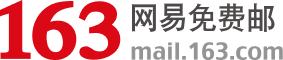
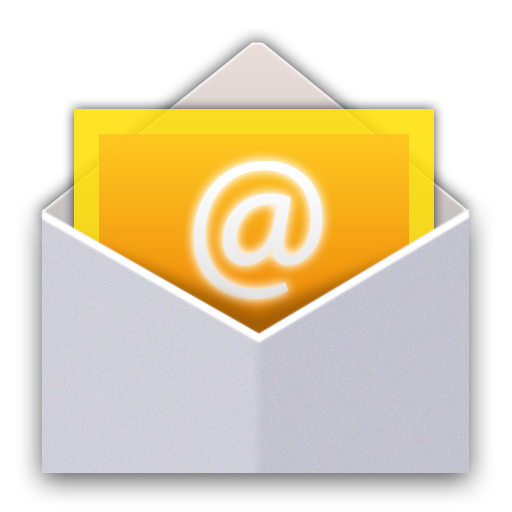
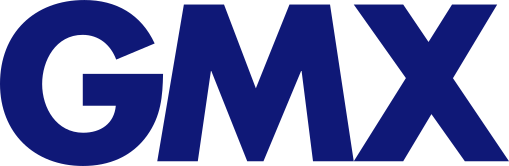
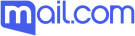
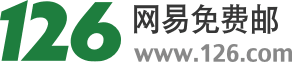
...
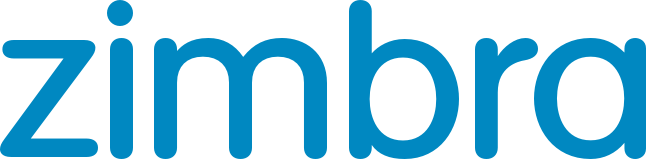
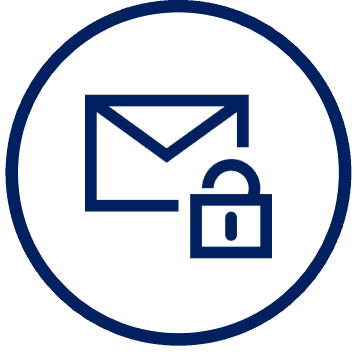
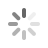
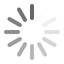
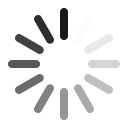

In [8]:
phishingtank_df['website']=phishingtank_df['url'].apply(lambda x: datacollection.collectdata(x,'../../dataset/phishing/htmlfiles'))
phishingtank_df.to_csv('phishing_dataset.csv',index=False)